In [ ]:
pip install scikit-learn==1.4.1.post1

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 12.1/12.1 MB 20.7 MB/s eta 0:00:00
  Attempting uninstall: scikit-learn
    Found existing installation: scikit-learn 1.2.2
    Uninstalling scikit-learn-1.2.2:
      Successfully uninstalled scikit-learn-1.2.2


In [1]:
import sklearn
sklearn.__version__

'1.2.2'

In [2]:
# Importing the necessary libraries
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.model_selection import train_test_split, GridSearchCV
from sklearn.preprocessing import StandardScaler, MinMaxScaler, LabelEncoder, OneHotEncoder
from sklearn.metrics import mean_squared_error, mean_absolute_error, r2_score
from sklearn.linear_model import LinearRegression
from sklearn.ensemble import RandomForestRegressor
from sklearn.neighbors import KNeighborsRegressor
from sklearn.tree import DecisionTreeRegressor
import warnings
warnings.filterwarnings('ignore')

In [3]:
%matplotlib inline

Dataset Link : [Kaggle](https://www.kaggle.com/datasets/ibrahimkiziloklu/solar-radiation-dataset/data)

In [4]:
# Loading the data into a DataFrame
df1 = pd.read_csv('/content/2017_2019.csv')
df2 = pd.read_csv('/content/solar_angles_dataset.csv')

In [5]:
print(df1.shape)
print(df2.shape)

(105120, 19)
(105216, 7)


In [6]:
df2['Year'] = pd.to_datetime(df2['Date (M/D/YYYY)']).dt.year
df2['Month'] = pd.to_datetime(df2['Date (M/D/YYYY)']).dt.month
df2['Day'] = pd.to_datetime(df2['Date (M/D/YYYY)']).dt.day

In [7]:
df2['Hour'] = pd.to_datetime(df2['Time (H:MM:SS)']).dt.hour
df2['Minute'] = pd.to_datetime(df2['Time (H:MM:SS)']).dt.minute

In [8]:
df2.drop(['Date (M/D/YYYY)', 'Time (H:MM:SS)', 'Unnamed: 0', 'Julian day'], axis = 1, inplace = True)

In [9]:
df2['Year'].value_counts()

Year
2017    35040
2018    35040
2019    35040
2020       96
Name: count, dtype: int64

In [10]:
df2.drop(df2.loc[df2['Year'] == 2020].index, axis = 0, inplace = True)

In [11]:
df1.shape, df2.shape

((105120, 19), (105120, 8))

In [12]:
df1.columns

Index(['Year', 'Month', 'Day', 'Hour', 'Minute', 'Temperature', 'Clearsky DHI',
       'Clearsky DNI', 'Clearsky GHI', 'Dew Point', 'DHI', 'DNI', 'GHI',
       'Relative Humidity', 'Solar Zenith Angle', 'Surface Albedo', 'Pressure',
       'Wind Speed', 'Unnamed: 18'],
      dtype='object')

In [13]:
df2.columns

Index(['Topocentric zenith angle', 'Top. azimuth angle (eastward from N)',
       'Top. azimuth angle (westward from S)', 'Year', 'Month', 'Day', 'Hour',
       'Minute'],
      dtype='object')

In [14]:
# droping this Unnamed columns as it is just an empty column
df1.drop(columns=['Unnamed: 18'], axis = 1, inplace=True)

In [15]:
# Set the index of df2 to the required columns
df2 = df2.set_index(['Year', 'Month', 'Day', 'Hour', 'Minute'])

In [16]:
df = df1.join(df2, how = 'inner', on = ['Year', 'Month', 'Day', 'Hour', 'Minute'])

In [17]:
# Number of rows and columns in the dataset
df.shape

(105120, 21)

In [18]:
# First 5 rows of the dataset
df.head()

,Year,Month,Day,Hour,Minute,Temperature,Clearsky DHI,Clearsky DNI,Clearsky GHI,Dew Point,...,DNI,GHI,Relative Humidity,Solar Zenith Angle,Surface Albedo,Pressure,Wind Speed,Topocentric zenith angle,Top. azimuth angle (eastward from N),Top. azimuth angle (westward from S)
0,2017,1,1,0,0,-0.6,0,0,0,-2.6,...,0,0,86.29,152.92,0.12,1003,1.7,157.863107,308.657327,128.657327
1,2017,1,1,0,15,-0.6,0,0,0,-2.6,...,0,0,86.29,150.22,0.12,1003,1.7,160.034217,316.136781,136.136781
2,2017,1,1,0,30,-0.6,0,0,0,-2.6,...,0,0,86.29,147.43,0.12,1003,1.7,161.901608,325.052191,145.052191
3,2017,1,1,0,45,-0.6,0,0,0,-2.7,...,0,0,85.54,144.60,0.12,1003,1.6,163.360197,335.548911,155.548911
4,2017,1,1,1,0,-0.7,0,0,0,-2.7,...,0,0,86.17,141.71,0.12,1003,1.6,164.293788,347.499018,167.499018


In [19]:
# dataframe information like column name and it's datatype,
# count of non-null values, number of features and instances
df.info()

<class 'pandas.core.frame.DataFrame'>
Index: 105120 entries, 0 to 105119
Data columns (total 21 columns):
 #   Column                                Non-Null Count   Dtype  
---  ------                                --------------   -----  
 0   Year                                  105120 non-null  int64  
 1   Month                                 105120 non-null  int64  
 2   Day                                   105120 non-null  int64  
 3   Hour                                  105120 non-null  int64  
 4   Minute                                105120 non-null  int64  
 5   Temperature                           105120 non-null  float64
 6   Clearsky DHI                          105120 non-null  int64  
 7   Clearsky DNI                          105120 non-null  int64  
 8   Clearsky GHI                          105120 non-null  int64  
 9   Dew Point                             105120 non-null  float64
 10  DHI                                   105120 non-null  int64  
 11  DNI  

In [20]:
# Number of null values in each feature
df.isna().sum()

Year                                    0
Month                                   0
Day                                     0
Hour                                    0
Minute                                  0
Temperature                             0
Clearsky DHI                            0
Clearsky DNI                            0
Clearsky GHI                            0
Dew Point                               0
DHI                                     0
DNI                                     0
GHI                                     0
Relative Humidity                       0
Solar Zenith Angle                      0
Surface Albedo                          0
Pressure                                0
Wind Speed                              0
Topocentric zenith angle                0
Top. azimuth angle (eastward from N)    0
Top. azimuth angle (westward from S)    0
dtype: int64

In [49]:
# Checking the data types of our features
df.dtypes

Year                                      int64
Month                                     int64
Day                                       int64
Hour                                      int64
Minute                                    int64
Temperature                             float64
Clearsky DHI                              int64
Clearsky DNI                              int64
Clearsky GHI                              int64
Dew Point                               float64
DHI                                       int64
DNI                                       int64
GHI                                       int64
Relative Humidity                       float64
Solar Zenith Angle                      float64
Surface Albedo                          float64
Pressure                                  int64
Wind Speed                              float64
Topocentric zenith angle                float64
Top. azimuth angle (eastward from N)    float64
Top. azimuth angle (westward from S)    

In [21]:
# Number of Unique values in each feature of the dataframe
df.nunique()

Year                                         3
Month                                       12
Day                                         31
Hour                                        24
Minute                                       4
Temperature                                454
Clearsky DHI                               442
Clearsky DNI                               998
Clearsky GHI                              1026
Dew Point                                  276
DHI                                        491
DNI                                        998
GHI                                       1026
Relative Humidity                         8272
Solar Zenith Angle                       14928
Surface Albedo                              69
Pressure                                    42
Wind Speed                                 109
Topocentric zenith angle                105070
Top. azimuth angle (eastward from N)    105111
Top. azimuth angle (westward from S)    105111
dtype: int64

Let's define each of these terms and understand their relationship to solar radiation:

1. **Clearsky Diffuse Horizontal Irradiance (DHI):**
   - Definition: The portion of solar radiation that reaches the Earth's surface after being scattered by molecules and particles in a clear sky (i.e., without clouds). It is measured on a horizontal surface.
   - Relationship to Solar Radiation: Represents the scattered component of sunlight under clear sky conditions.

2. **Clearsky Direct Normal Irradiance (DNI):**
   - Definition: The amount of solar radiation received per unit area by a surface that is always held perpendicular (normal) to the rays of the sun under clear sky conditions.
   - Relationship to Solar Radiation: Represents the direct beam of sunlight when no clouds are present.

3. **Clearsky Global Horizontal Irradiance (GHI):**
   - Definition: The total amount of solar radiation received per unit area by a horizontal surface under clear sky conditions. It includes both direct solar radiation and diffuse radiation.
   - Relationship to Solar Radiation: GHI = DNI * cos(θ) + DHI, where θ is the solar zenith angle.

4. **Dew Point:**
   - Definition: The temperature at which air becomes saturated with moisture and water vapor begins to condense into liquid water.
   - Relationship to Solar Radiation: While not a direct measure of solar radiation, the dew point affects atmospheric transparency and cloud formation, which in turn influence solar radiation reaching the surface.

5. **Diffuse Horizontal Irradiance (DHI):**
   - Definition: The portion of solar radiation reaching the Earth's surface after being scattered by molecules and particles in the atmosphere (not just under clear sky conditions).
   - Relationship to Solar Radiation: Represents the scattered component of sunlight, regardless of whether the sky is clear or cloudy.

6. **Direct Normal Irradiance (DNI):**
   - Definition: The amount of solar radiation received per unit area by a surface that is perpendicular to the rays of the sun. This measure does not change with the sky condition.
   - Relationship to Solar Radiation: Represents the direct beam of sunlight and is crucial for concentrating solar power systems.

7. **Global Horizontal Irradiance (GHI):**
   - Definition: The total amount of solar radiation received per unit area by a horizontal surface. It includes both direct solar radiation and diffuse radiation.
   - Relationship to Solar Radiation: GHI = DNI * cos(θ) + DHI, considering all sky conditions.

8. **Relative Humidity:**
   - Definition: The amount of water vapor present in air expressed as a percentage of the amount needed for saturation at the same temperature.
   - Relationship to Solar Radiation: High relative humidity can increase the scattering of solar radiation and reduce the amount of direct solar radiation reaching the surface.

9. **Solar Zenith Angle:**
   - Definition: The angle between the vertical and the line to the sun. It is complementary to the solar elevation angle.
   - Relationship to Solar Radiation: Affects the intensity of solar radiation received on a surface. Lower angles (when the sun is higher in the sky) result in higher solar intensity.

10. **Surface Albedo:**
    - Definition: The fraction of solar energy reflected from the Earth's surface. It varies depending on the surface material (e.g., snow, water, vegetation).
    - Relationship to Solar Radiation: Determines how much solar radiation is absorbed by the surface versus how much is reflected back into the atmosphere.

11. **Pressure Value:**
    - Definition: The atmospheric pressure at a given location, usually measured in hectopascals (hPa) or millibars (mb).
    - Relationship to Solar Radiation: Influences the density of the atmosphere, which in turn affects the scattering and absorption of solar radiation.

12. **Wind Speed Value:**
    - Definition: The speed of the wind at a given location, usually measured in meters per second (m/s) or kilometers per hour (km/h).
    - Relationship to Solar Radiation: Wind can affect the distribution of aerosols and moisture in the atmosphere, which can impact the scattering and absorption of solar radiation.


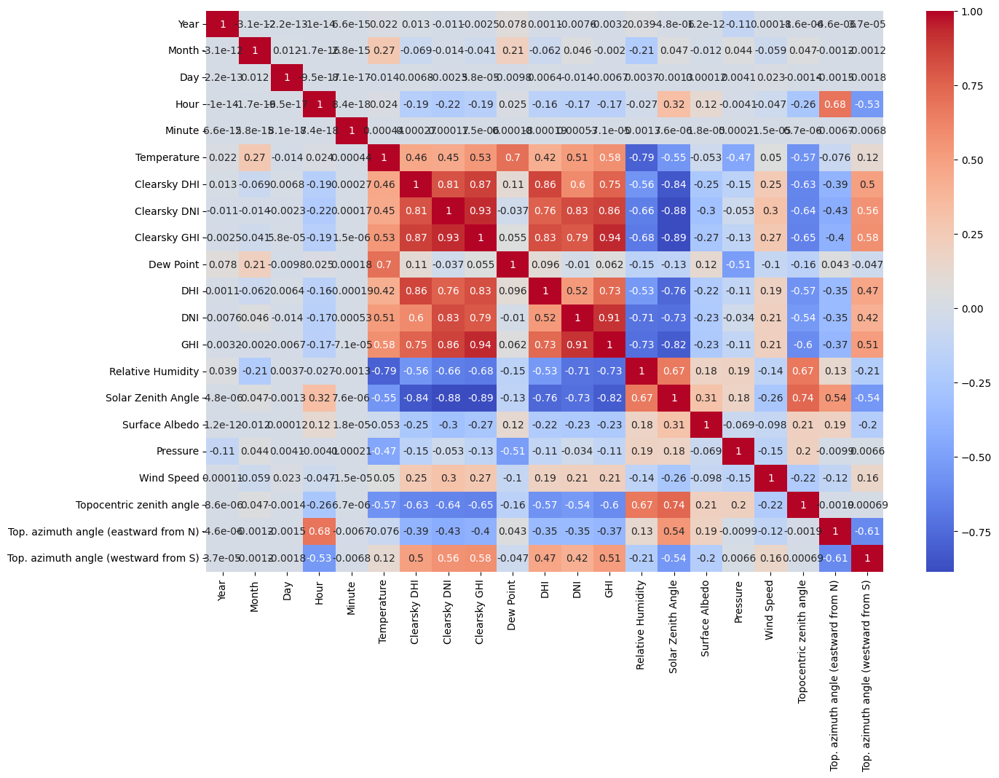

In [ ]:
fig, ax = plt.subplots(figsize = (15, 10))
sns.heatmap(df.corr(), annot = True, cmap = 'coolwarm', ax = ax)
plt.show()

In [ ]:
!pip install autoviz

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 67.5/67.5 kB 2.4 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 431.4/431.4 kB 7.6 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.9/1.9 MB 13.3 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 255.9/255.9 MB 5.4 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 155.4/155.4 kB 18.0 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 24.7/24.7 MB 36.9 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 8.3/8.3 MB 91.7 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 7.0/7.0 MB 89.9 MB/s eta 0:00:00
  Attempting uninstall: xgboost
    Found existing installation: xgboost 2.0.3
    Uninstalling xgboost-2.0.3:
      Successfully uninstalled xgboost-2.0.3
  Attempting uninstall: matplotlib
    Found existing installation: matplotlib 3.7.1
    Uninstalling matplotlib-3.7.1:
      Successfully uninstalled matplotlib-3.7.1
  Attempting uninstall: bokeh
 

In [ ]:
from autoviz.AutoViz_Class import AutoViz_Class
AV = AutoViz_Class()

Imported v0.1.904. Please call AutoViz in this sequence:
    AV = AutoViz_Class()
    %matplotlib inline
    dfte = AV.AutoViz(filename, sep=',', depVar='', dfte=None, header=0, verbose=1, lowess=False,
               chart_format='svg',max_rows_analyzed=150000,max_cols_analyzed=30, save_plot_dir=None)


In [ ]:
AV.AutoViz(df)

Shape of your Data Set loaded: (105120, 21)
#######################################################################################
######################## C L A S S I F Y I N G  V A R I A B L E S  ####################
#######################################################################################
Classifying variables in data set...
    Number of Numeric Columns =  9
    Number of Integer-Categorical Columns =  11
    Number of String-Categorical Columns =  0
    Number of Factor-Categorical Columns =  0
    Number of String-Boolean Columns =  0
    Number of Numeric-Boolean Columns =  0
    Number of Discrete String Columns =  0
    Number of NLP String Columns =  0
    Number of Date Time Columns =  1
    Number of ID Columns =  0
    Number of Columns to Delete =  0
    21 Predictors classified...
        No variables removed since no ID or low-information variables found in data set
To fix these data quality issues in the dataset, import FixDQ from autoviz...
    All vari

,Data Type,Missing Values%,Unique Values%,Minimum Value,Maximum Value,DQ Issue
Year,int64,0.000000,0,2017.000000,2019.000000,Possible date-time colum: transform before modeling step.
Month,int64,0.000000,0,1.000000,12.000000,No issue
Day,int64,0.000000,0,1.000000,31.000000,No issue
Hour,int64,0.000000,0,0.000000,23.000000,No issue
Minute,int64,0.000000,0,0.000000,45.000000,No issue
Temperature,float64,0.000000,NA,-4.000000,41.400000,No issue
Clearsky DHI,int64,0.000000,0,0.000000,529.000000,"Column has 851 outliers greater than upper bound (272.50) or lower than lower bound(-163.50). Cap them or remove them., Column has a high correlation with ['Solar Zenith Angle']. Consider dropping one of them."
Clearsky DNI,int64,0.000000,0,0.000000,1005.000000,"Column has a high correlation with ['Solar Zenith Angle', 'Clearsky DHI']. Consider dropping one of them."
Clearsky GHI,int64,0.000000,0,0.000000,1030.000000,"Column has a high correlation with ['Solar Zenith Angle', 'Clearsky DHI', 'Clearsky DNI']. Consider dropping one of them."
Dew Point,float64,0.000000,NA,-5.300000,22.400000,Column has 792 outliers greater than upper bound (24.55) or lower than lower bound(-2.25). Cap them or remove them.


Number of All Scatter Plots = 45
All Plots done
Time to run AutoViz = 89 seconds 

 ###################### AUTO VISUALIZATION Completed ########################


,Year,Month,Day,Hour,Minute,Temperature,Clearsky DHI,Clearsky DNI,Clearsky GHI,Dew Point,DHI,DNI,GHI,Relative Humidity,Solar Zenith Angle,Surface Albedo,Pressure,Wind Speed,Topocentric zenith angle,Top. azimuth angle (eastward from N),Top. azimuth angle (westward from S)
0,2017,1,1,0,0,-0.6,0,0,0,-2.6,0,0,0,86.29,152.92,0.12,1003,1.7,157.863107,308.657327,128.657327
1,2017,1,1,0,15,-0.6,0,0,0,-2.6,0,0,0,86.29,150.22,0.12,1003,1.7,160.034217,316.136781,136.136781
2,2017,1,1,0,30,-0.6,0,0,0,-2.6,0,0,0,86.29,147.43,0.12,1003,1.7,161.901608,325.052191,145.052191
3,2017,1,1,0,45,-0.6,0,0,0,-2.7,0,0,0,85.54,144.60,0.12,1003,1.6,163.360197,335.548911,155.548911
4,2017,1,1,1,0,-0.7,0,0,0,-2.7,0,0,0,86.17,141.71,0.12,1003,1.6,164.293788,347.499018,167.499018
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
105115,2019,12,31,22,45,4.0,0,0,0,4.0,0,0,0,100.00,163.63,0.12,999,2.0,144.783756,284.815483,104.815483
105116,2019,12,31,23,0,3.9,0,0,0,3.9,0,0,0,100.00,162.09,0.12,999,2.0,147.598548,288.399718,108.399718
105117,2019,12,31,23,15,3.9,0,0,0,3.9,0,0,0,100.00,160.16,0.12,999,2.0,150.351476,292.434205,112.434205
105118,2019,12,31,23,30,3.9,0,0,0,3.9,0,0,0,100.00,157.93,0.12,999,2.0,153.019537,297.047016,117.047016


In [ ]:
%matplotlib inline

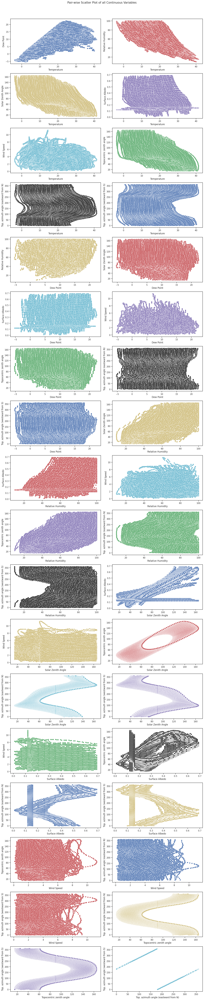

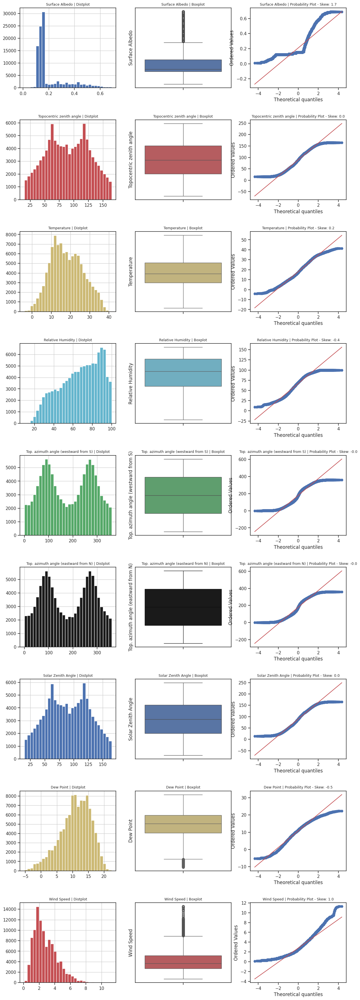

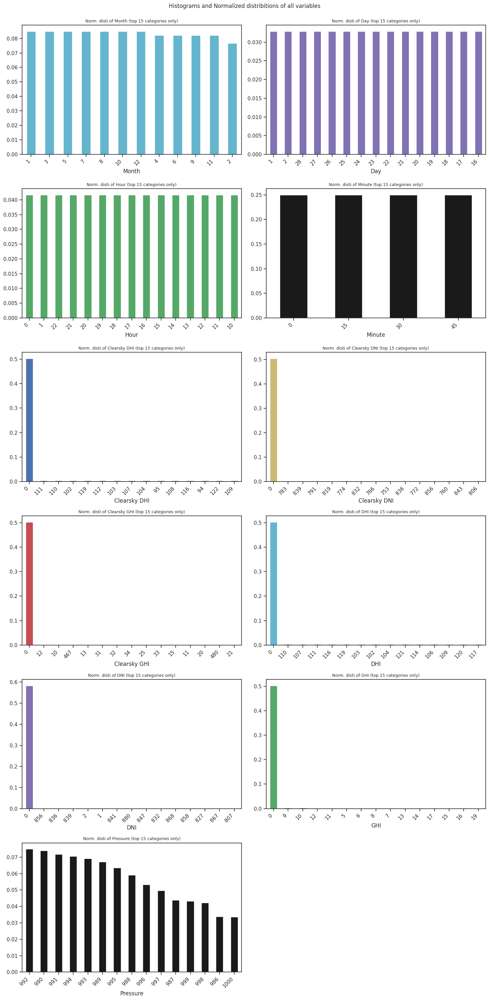

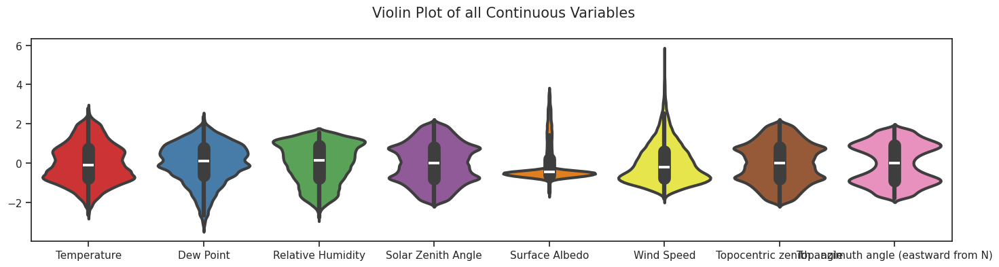

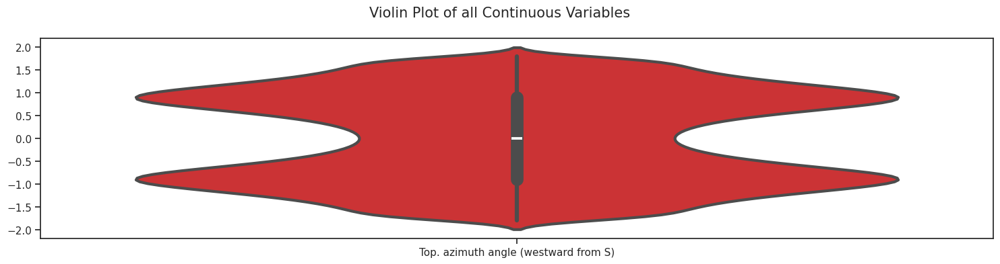

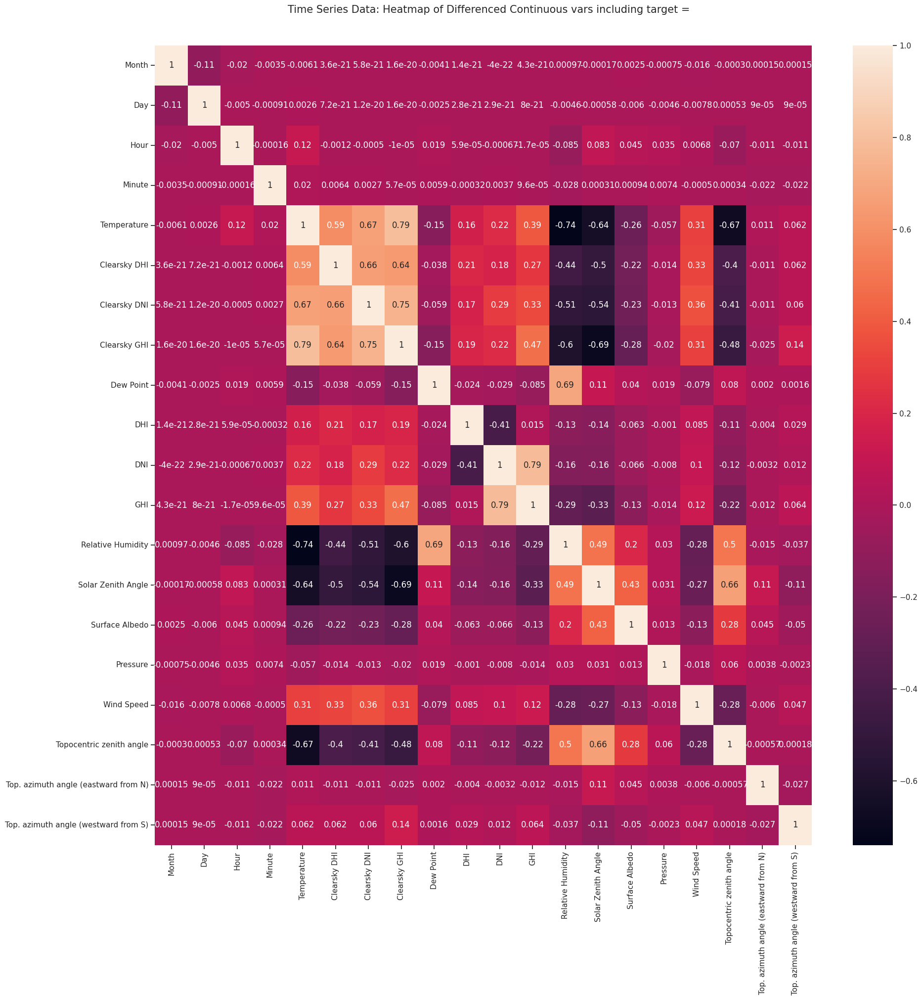

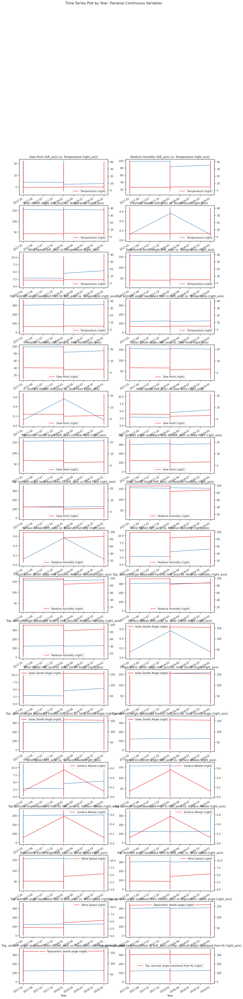

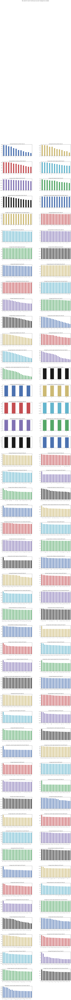

In [ ]:
plt.show()

In [22]:
df.columns

Index(['Year', 'Month', 'Day', 'Hour', 'Minute', 'Temperature', 'Clearsky DHI',
       'Clearsky DNI', 'Clearsky GHI', 'Dew Point', 'DHI', 'DNI', 'GHI',
       'Relative Humidity', 'Solar Zenith Angle', 'Surface Albedo', 'Pressure',
       'Wind Speed', 'Topocentric zenith angle',
       'Top. azimuth angle (eastward from N)',
       'Top. azimuth angle (westward from S)'],
      dtype='object')

In [ ]:
numerical_features = [col for col in df.columns if df[col].dtype != 'O']
categorical_features = [col for col in df.columns if df[col].dtype == 'O']

In [37]:
continuous_features = ['Temperature', 'Dew Point', 'Relative Humidity', 'Solar Zenith Angle', 'Surface Albedo', 'Wind Speed', 'Topocentric zenith angle', 'Top. azimuth angle (eastward from N)', 'Top. azimuth angle (westward from S)']


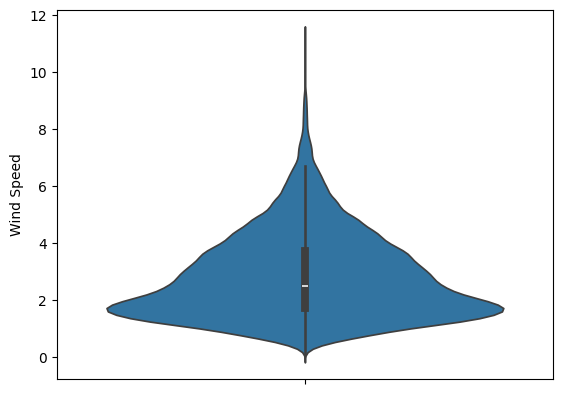

<Figure size 1500x1000 with 0 Axes>

In [47]:
sns.violinplot(df['Wind Speed'])
plt.figure(figsize=(15, 10))
plt.show()

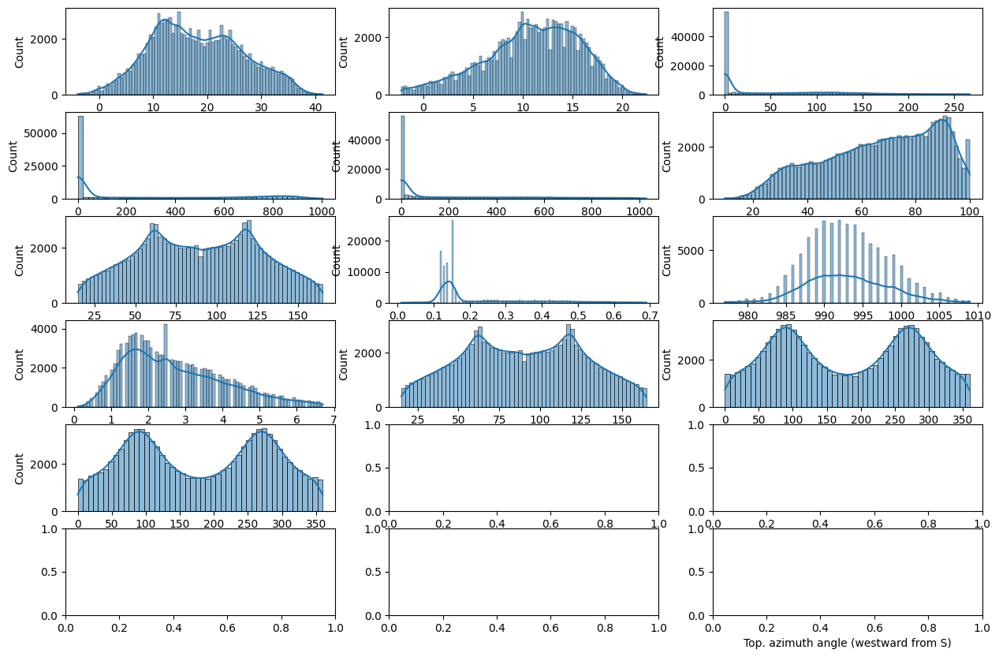

In [ ]:
fig, ax = plt.subplots(6, 3)
fig.set_size_inches(15, 10)
ax = ax.ravel()
for col, ax in zip(numerical_features, ax) :
  sns.histplot(df[col], kde = True, ax = ax)
  plt.xlabel(col)
plt.show()

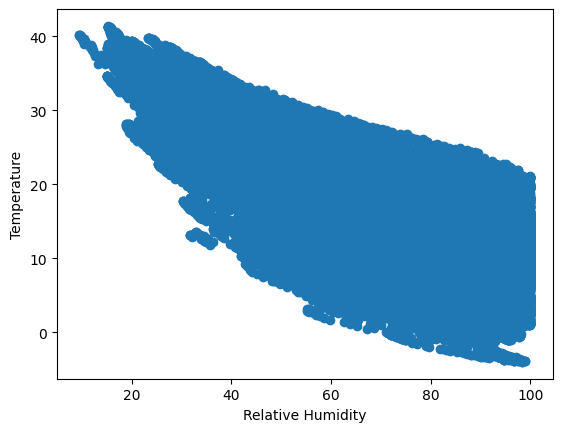

In [32]:
plt.scatter(df['Relative Humidity'], df['Temperature'])
plt.xlabel(df['Relative Humidity'].name)
plt.ylabel(df['Temperature'].name)
plt.show()

In [ ]:
plt.

In [25]:
from scipy.stats import linregress

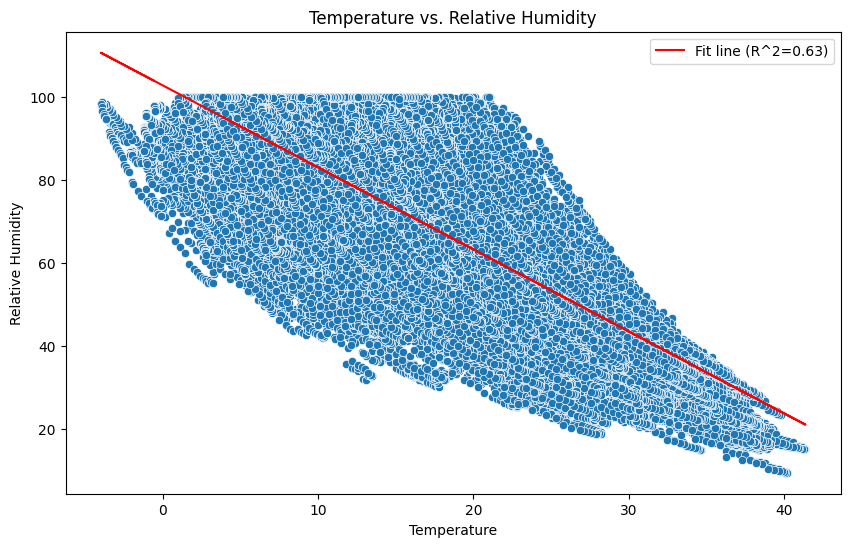

In [27]:
plt.figure(figsize=(10, 6))
sns.scatterplot(x='Temperature', y='Relative Humidity', data=df)

# Fit regression line
slope, intercept, r_value, p_value, std_err = linregress(df['Temperature'], df['Relative Humidity'])
plt.plot(df['Temperature'], intercept + slope * df['Temperature'], 'r', label=f'Fit line (R^2={r_value**2:.2f})')
plt.legend()

plt.title('Temperature vs. Relative Humidity')
plt.xlabel('Temperature')
plt.ylabel('Relative Humidity')
plt.show()

In [48]:
# Descriptive statistics
df.describe()

,Year,Month,Day,Hour,Minute,Temperature,Clearsky DHI,Clearsky DNI,Clearsky GHI,Dew Point,...,DNI,GHI,Relative Humidity,Solar Zenith Angle,Surface Albedo,Pressure,Wind Speed,Topocentric zenith angle,Top. azimuth angle (eastward from N),Top. azimuth angle (westward from S)
count,105120.0000,105120.000000,105120.000000,105120.000000,105120.00000,105120.000000,105120.000000,105120.00000,105120.000000,105120.000000,...,105120.000000,105120.000000,105120.000000,105120.000000,105120.000000,105120.000000,105120.000000,105120.000000,105120.000000,105120.000000
mean,2018.0000,6.526027,15.720548,11.500000,22.50000,18.089326,56.890801,307.54610,236.706003,10.818985,...,226.459218,197.957953,67.121768,89.672306,0.210081,992.998564,2.807034,89.670556,179.902513,179.912787
std,0.8165,3.447868,8.796289,6.922219,16.77059,8.414004,70.736008,353.37831,311.137694,4.891790,...,330.200514,291.881178,20.904710,37.113972,0.132029,5.357458,1.499126,36.940163,100.619778,100.113409
min,2017.0000,1.000000,1.000000,0.000000,0.00000,-4.000000,0.000000,0.00000,0.000000,-5.300000,...,0.000000,0.000000,9.530000,14.620000,0.010000,971.000000,0.100000,14.967263,0.000587,0.022977
25%,2017.0000,4.000000,8.000000,5.750000,11.25000,11.700000,0.000000,0.00000,0.000000,7.800000,...,0.000000,0.000000,51.460000,60.350000,0.130000,989.000000,1.700000,60.580146,89.604008,90.249359
50%,2018.0000,7.000000,16.000000,11.500000,22.50000,17.400000,0.000000,0.00000,0.000000,11.300000,...,0.000000,0.000000,69.830000,89.300000,0.150000,993.000000,2.500000,89.315080,179.986947,180.016186
75%,2019.0000,10.000000,23.000000,17.250000,33.75000,24.200000,109.000000,687.00000,471.000000,14.500000,...,499.000000,360.000000,85.260000,119.130000,0.240000,997.000000,3.700000,118.884310,270.237919,269.608531
max,2019.0000,12.000000,31.000000,23.000000,45.00000,41.400000,529.000000,1005.00000,1030.000000,22.400000,...,1005.000000,1030.000000,100.000000,165.340000,0.690000,1012.000000,11.300000,164.993728,359.996736,359.996582


In [50]:
features_to_drop = ['Clearsky DHI', 'Clearsky DNI', 'Clearsky GHI']
df.drop(df[features_to_drop], axis = 1, inplace = True)

In [51]:
features_with_outliers = ['Dew Point', 'DHI', 'Surface Albedo', 'Pressure', 'Wind Speed']

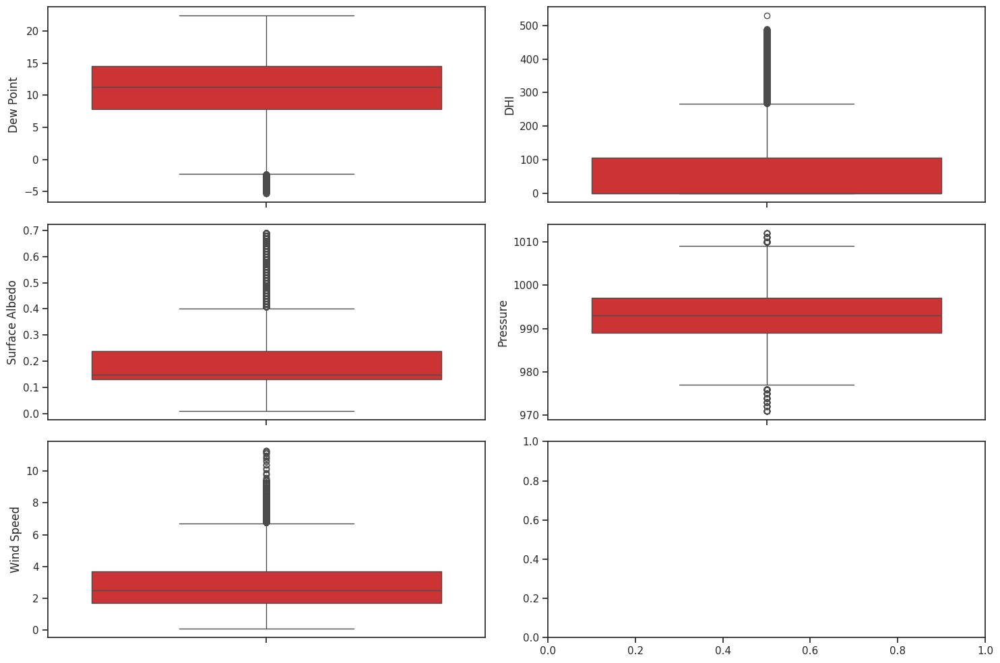

In [ ]:
fig, ax = plt.subplots(3, 2)
fig.set_size_inches(15, 10)
ax = ax.ravel()
for col, ax in zip(features_with_outliers, ax) :
    sns.boxplot(df[col], ax = ax)
plt.tight_layout()
plt.show()

In [52]:
for col in features_with_outliers :
  q3 = df[col].quantile(0.75)
  q1 = df[col].quantile(0.25)
  iqr = q3 - q1
  upper_limit = q3 + 1.5 * iqr
  lower_limit = q1 - 1.5 * iqr
  median = df[col].median()
  df[col] = np.where(df[col] > upper_limit, median, df[col])
  df[col] = np.where(df[col] < lower_limit, median, df[col])

In [53]:
df['DHI'] = np.where(df['DHI'] > 267.0, df['DHI'].median(), df['DHI'])
df['DHI'] = np.where(df['DHI'] < -160.50, df['DHI'].median(), df['DHI'])

In [54]:
df['Surface Albedo'] = df1['Surface Albedo']

In [55]:
ghi_df = df.loc[df['GHI'] == 0]

In [56]:
ghi_df.Hour.value_counts()

Hour
0     4380
1     4380
2     4380
18    4380
19    4380
20    4380
21    4380
22    4380
23    4380
17    3896
3     3326
16    2415
4     1939
15    1225
5      625
14      67
Name: count, dtype: int64

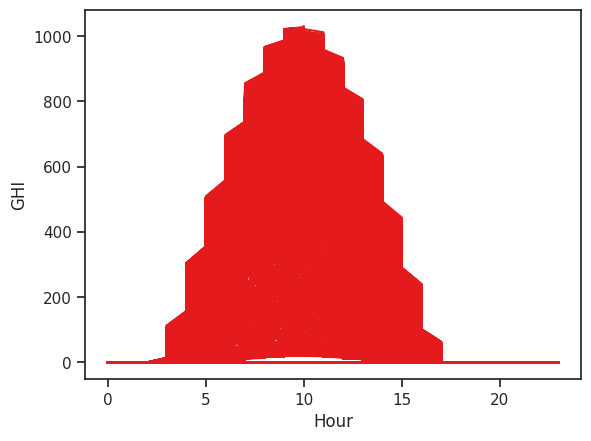

In [ ]:
plt.plot(df['Hour'], df['GHI'])
plt.xlabel('Hour')
plt.ylabel('GHI')
plt.show()

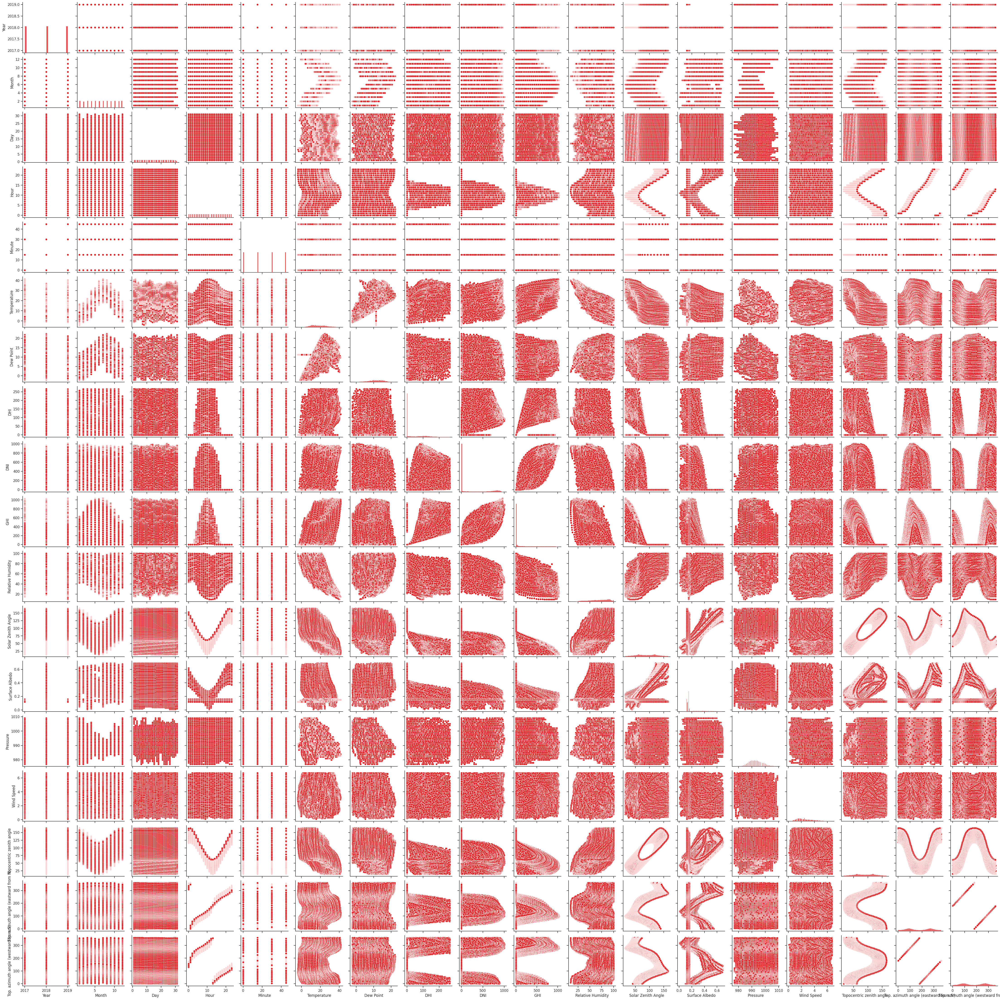

In [ ]:
sns.pairplot(df)
plt.show()

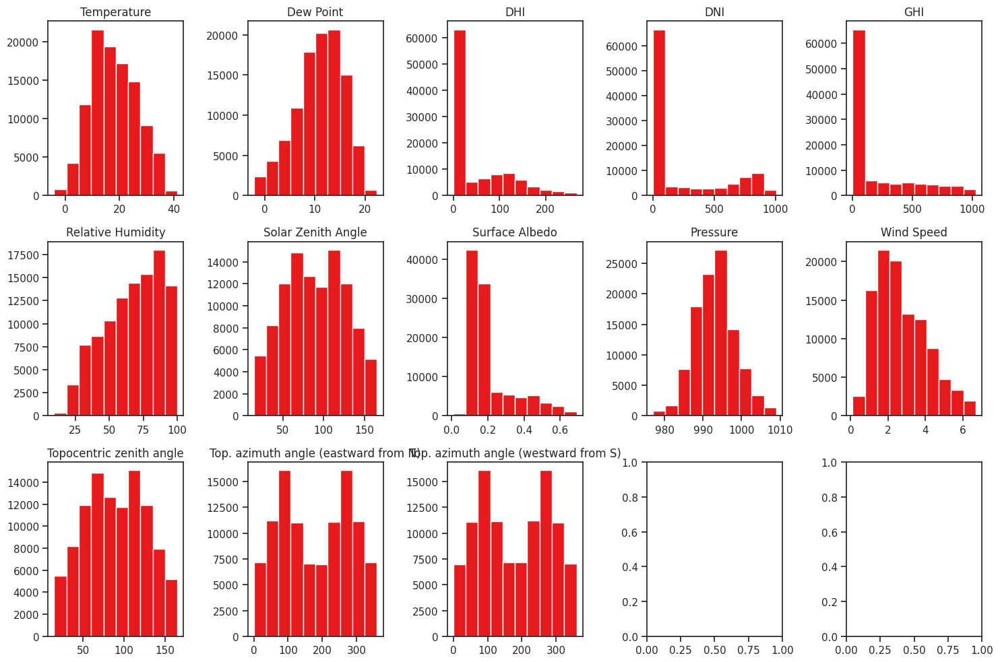

In [ ]:
fig, ax = plt.subplots(3, 5)
fig.set_size_inches(15, 10)
ax = ax.ravel()
for col, ax in zip(df.columns[5:], ax) :
    ax.hist(df[col])
    ax.set_title(col)
plt.tight_layout()
plt.show()

In [57]:
right_skewed = ['DHI', 'DNI', 'GHI', 'Surface Albedo', 'Wind Speed']
left_skewed = ['Relative Humidity', 'Dew Point']

We are not going to apply any log function to the features as 0 means something if we are to apply it will change the meaning of the feature value

In [58]:
X = df.drop(['GHI'], axis = 1)
y = df[['GHI']]

In [59]:
# Creating a standard Scaler for feature scaling of training and testing data
scaler = StandardScaler().fit(X)
X_scaled = pd.DataFrame(scaler.transform(X), columns = X.columns)

In [60]:
X_train, X_test, y_train, y_test = train_test_split(X_scaled, y, test_size=0.2, random_state=42)

In [62]:
print(f'The dimenionality of the X_train is {X_train.shape}')
print(f'The dimenionality of the X_test is {X_test.shape}')
print(f'The dimenionality of the y_train is {y_train.shape}')
print(f'The dimenionality of the y_test is {y_test.shape}')

The dimenionality of the X_train is (84096, 17)
The dimenionality of the X_test is (21024, 17)
The dimenionality of the y_train is (84096, 1)
The dimenionality of the y_test is (21024, 1)


In [ ]:
lr = LinearRegression()
rf = RandomForestRegressor()
knn = KNeighborsRegressor()
dt = DecisionTreeRegressor()

In [63]:
lr = LinearRegression()
lr.fit(X_train, y_train)
lr_y_pred = lr.predict(X_test)
print(f"The Mean Absolute error is {mean_absolute_error(y_test, lr_y_pred)}")
print(f"The Mean Squared error is {mean_squared_error(y_test, lr_y_pred)}")
print(f"The R2 score is {r2_score(y_test, lr_y_pred)}")

The Mean Absolute error is 70.45595292877438
The Mean Squared error is 8373.447583624693
The R2 score is 0.9013732259216886


In [64]:
rf = RandomForestRegressor()
rf.fit(X_train, y_train)
rf_y_pred = rf.predict(X_test)
print(f"The Mean Absolute error is {mean_absolute_error(y_test, rf_y_pred)}")
print(f"The Mean Squared error is {mean_squared_error(y_test, rf_y_pred)}")
print(f"The R2 score is {r2_score(y_test, rf_y_pred)}")

The Mean Absolute error is 1.165047089041096
The Mean Squared error is 9.173791500190259
The R2 score is 0.9998919463634668


In [65]:
knn = KNeighborsRegressor()
knn.fit(X_train, y_train)
knn_y_pred = knn.predict(X_test)
print(f"The Mean Absolute error is {mean_absolute_error(y_test, knn_y_pred)}")
print(f"The Mean Squared error is {mean_squared_error(y_test, knn_y_pred)}" )
print(f"The R2 score is {r2_score(y_test, knn_y_pred)}")

The Mean Absolute error is 16.61646689497717
The Mean Squared error is 1142.1894235159818
The R2 score is 0.9865467052725033


In [66]:
dt = DecisionTreeRegressor()
dt.fit(X_train, y_train)
dt_y_pred = dt.predict(X_test)
print(f"The Mean Absolute error is {mean_absolute_error(y_test, dt_y_pred)}")
print(f"The Mean Squared error is {mean_squared_error(y_test, dt_y_pred)}")
print(f"The R2 score is {r2_score(y_test, dt_y_pred)}")

The Mean Absolute error is 2.1893074581430745
The Mean Squared error is 26.448154490106546
The R2 score is 0.9996884800278938


In [ ]:
X_test.head()

,Year,Month,Day,Hour,Minute,Temperature,Dew Point,DHI,DNI,Relative Humidity,Solar Zenith Angle,Surface Albedo,Pressure,Wind Speed,Topocentric zenith angle,Top. azimuth angle (eastward from N),Top. azimuth angle (westward from S)
103058,1.224745,1.587648,-0.650340,0.072232,0.447214,-0.283972,-1.252486,0.653788,1.270570,-0.871663,-0.532479,-0.682285,-0.567692,0.056774,-0.755080,-0.086799,1.710629
72825,1.224745,-1.602745,1.509672,0.361158,-0.447214,-0.592982,-0.090643,-0.384436,-0.685827,0.828441,-0.321237,-0.682285,-0.756567,2.335012,-0.869272,0.143386,-1.653961
86757,1.224745,-0.152567,0.827563,0.794547,-0.447214,1.070919,1.155698,-0.399704,-0.379950,-0.730067,-0.078470,-0.530802,-0.189941,-0.531158,-0.993789,0.916839,-0.876595
72842,1.224745,-1.602745,1.509672,0.939010,0.447214,-0.795027,-0.238514,-0.720331,-0.685827,1.076233,0.964000,-0.682285,-0.945443,2.188029,0.033519,0.673765,-1.120900
78121,1.224745,-1.022674,1.054933,0.939010,-0.447214,-0.997072,-0.935620,-0.720331,-0.685827,0.633269,0.588398,-0.606544,-0.756567,-0.163700,-0.353120,0.812607,-0.981355


In [67]:
rf.predict([[1.224, 1.587, -0.650, 0.07, 0.447, -0.283, -1.252, 0.653, 1.270, -0.871, -0.532, -0.682, -0.567, 0.0567, -0.755, -0.086, 1.710]])

array([307.75])

In [ ]:
print(lr.score(X_test, y_test))
print(lr.score(X_train, y_train))

0.9013732259216886
0.9028258625614904


In [ ]:
rf.score(X_test, y_test), rf.score(X_train, y_train)

(0.9998914990109019, 0.9999857273256777)

In [ ]:
knn.score(X_test, y_test), knn.score(X_train, y_train)

(0.9865467052725033, 0.9915411545971774)

In [ ]:
dt.score(X_test, y_test), dt.score(X_train, y_train)

(0.9996852631219546, 1.0)

In [ ]:
rf_y_pred = rf.predict(X_test)
mean_squared_error(y_test, rf_y_pred)

9.688962913812786

In [ ]:
mean_absolute_error(y_test, rf_y_pred)

1.1843126902587517

In [ ]:
X_train.columns

Index(['Year', 'Month', 'Day', 'Hour', 'Minute', 'Temperature', 'Dew Point',
       'DHI', 'DNI', 'Relative Humidity', 'Solar Zenith Angle',
       'Surface Albedo', 'Pressure', 'Wind Speed', 'Topocentric zenith angle',
       'Top. azimuth angle (eastward from N)',
       'Top. azimuth angle (westward from S)'],
      dtype='object')

In [68]:
tmp = [2024, 5, 22, 1, 35, 36, 21, 51, 43, 41, 220, 0.12, 1005, 6, 152, 253, 306]

In [69]:
tmp = scaler.transform([tmp])

In [70]:
rf.predict(tmp)

array([58.02])

In [ ]:
X.columns

Index(['Year', 'Month', 'Day', 'Hour', 'Minute', 'Temperature', 'Dew Point',
       'DHI', 'DNI', 'Relative Humidity', 'Solar Zenith Angle',
       'Surface Albedo', 'Pressure', 'Wind Speed', 'Topocentric zenith angle',
       'Top. azimuth angle (eastward from N)',
       'Top. azimuth angle (westward from S)'],
      dtype='object')

In [71]:
import pickle

In [72]:
pickle.dump(scaler, open('scaler.pkl', 'wb'))
pickle.dump(rf, open('model.pkl', 'wb'))

In [74]:
df.iloc[127]

Year                                    2017.000000
Month                                      1.000000
Day                                        2.000000
Hour                                       7.000000
Minute                                    45.000000
Temperature                                4.600000
Dew Point                                 -1.500000
DHI                                       63.000000
DNI                                      806.000000
GHI                                      334.000000
Relative Humidity                         64.770000
Solar Zenith Angle                        70.350000
Surface Albedo                             0.130000
Pressure                                1002.000000
Wind Speed                                 1.700000
Topocentric zenith angle                  98.516621
Top. azimuth angle (eastward from N)     112.538500
Top. azimuth angle (westward from S)     292.538500
Name: 127, dtype: float64